# Direct Digital Synthesis

#### Hunter Adams (vha3)

In [4]:
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [3]:
import numpy
import matplotlib.pyplot as plt
from IPython.display import Audio
from IPython.display import Image
from scipy import signal
from scipy.fft import fftshift
from scipy.fft import fft, fftfreq
from scipy.io import wavfile
plt.rcParams['figure.figsize'] = [12, 4]
from IPython.core.display import HTML
from matplotlib import animation, rc
from IPython.display import HTML
from IPython.display import clear_output
HTML("""
<style>
.output_png {
    display: table-cell;
    text-align: center;
    vertical-align: middle;
}
</style>
""")

## Webpage table of contents

> - [Video discussion](#Video-discussion-of-content-on-this-page)
> - [The central abstraction](#The-central-abstraction)
> - [The DDS algorithm](#The-DDS-Algorithm)
> - [Examples and analysis](#Examples-and-Analysis)
> - [Sine table size](#How-big-does-our-sine-table-need-to-be?)
> - [Common questions and comments](#Some-common-questions-and-comments)
> - [Frequency modulation with DDS](#Frequency-modulation-using-DDS)
> - [Practical considerations for implementation on the PIC32](#Practical-considerations-for-implementation-on-the-PIC32)

## Video discussion of content on this page

<iframe width="560" height="315" src="https://www.youtube.com/embed/zpFWWUKLyXE" frameborder="0" allow="accelerometer; autoplay; clipboard-write; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>

## The central abstraction

The observation upon which the direct digital synthesis algorithm is based is that a *variable overflowing is **isomorphic** to one rotation of a phasor*. Recall from some math class years ago that a sine wave is generated by projecting a rotating phasor onto the imaginary axis, as shown below. We see the rotating phasor and it's associated angle in red, the projection onto the imaginary axis in green, and the generated sine wave streaming off in orange. Note that, after the phasor has rotated 360 degrees, we have completed one period of the sine wave and the whole thing repeats.

Now, suppose that we represented the angle of that phasor, from the positive x-axis, with a 32-bit number that we'll call the **accumulator**. A scaled version of the phase angle will be stored in the accumulator. An angle of 0 degrees from the positive x-axis will correspond to an accumulator value of 0 (a 0 in each of the 32 bits). An angle of 360 degrees from the positive x-axis will correspond to an accumulator value of $2^{32}-1$ (a 1 in each of the 32 bits). Then, overflowing the accumulator corresponds to completing a full rotation of the phasor.

We'll see why this is useful in the next section. For now, all that we've done is scaled the range of phasor angles from $0 \rightarrow 2\pi$ radians to instead $0 \rightarrow 2^{32}-1$ units, and stored that rescaled value in a 32-bit variable that we are calling **accumulator.**

In [5]:
angles = numpy.linspace(0, 2*numpy.pi, 256)

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(figsize=(21, 7.77))

ax.set_xlim((-1.57, 7.85))
ax.set_ylim((-1.57, 2.0))
# ax.plot([-1.3, -0.6], [1.33, 1.33], 'b-')

ann = ax.annotate("Phase angle (rad): 0", xy=(-1.3, 1.78), xytext=(-1.3, 1.78), fontsize=18, alpha=0.4)
ann1 = ax.annotate("Phase angle, scaled to 0-$2^{32}$ and represented in binary (\"Accumulator\")",
                   xy=(-1.3, 1.5), xytext=(-1.3, 1.5), fontsize=18, alpha=0.4)
ann2 = ax.annotate('{0:032b}'.format(0), xy=(-1.3, 1.35), xytext=(-1.3, 1.35), fontsize=18, alpha=0.4)

# ann3 = ax.annotate('indexes into 256-entry sine table',
#             xy=(-0.95, 1.33),
#             xytext=(0.01, 0.75), textcoords='axes fraction',
#             arrowprops=dict(facecolor='black', shrink=0.01),
#             horizontalalignment='left', verticalalignment='top')


line, = ax.plot(numpy.cos(angles), numpy.sin(angles))
line1, = ax.plot([],[], 'black', alpha=0.1)
line2, = ax.plot([], [], 'black', alpha=0.1)
line3, = ax.plot([],[], 'green', linewidth=2)
line4, = ax.plot([], [], 'r.')
line5, = ax.plot([], [], 'orange')
line6, = ax.plot([], [], 'r-')
line7, = ax.plot([], [], 'r-')



# initialization function: plot the background of each frame
def init():
    line.set_data(numpy.cos(angles), numpy.sin(angles))
    line1.set_data([-1.1, 1.1], [0, 0])
    line2.set_data([0, 0], [-1.1, 1.1])
    line3.set_data([0, 0],[0, numpy.sin(0)])
    line4.set_data(0, numpy.sin(0))
    line5.set_data(numpy.linspace(0, 7.85, 256), numpy.sin(0 - numpy.linspace(0, 7.85, 256)))
    line6.set_data([0, numpy.cos(0)], [0, numpy.sin(0)])
    line7.set_data([], [])
    
    return (line, line1, line2, line3, line4, line5, line6, line7,)


def animate(i):
    global ann
    global ann2
    ann.remove()
    ann2.remove()
    line.set_data(numpy.cos(angles), numpy.sin(angles))
    line1.set_data([-1.1, 1.1], [0, 0])
    line2.set_data([0, 0], [-1.1, 1.1])
    line3.set_data([0, 0],[0, numpy.sin(angles[i])])
    line4.set_data(0, numpy.sin(angles[i]))
    line5.set_data(numpy.linspace(0, 7.85, 256), numpy.sin(angles[i] - numpy.linspace(0, 7.85, 256)))
    line6.set_data([0, numpy.cos(angles[i])], [0, numpy.sin(angles[i])])
    line7.set_data(numpy.cos(numpy.linspace(0, angles[i], 100))*0.1, numpy.sin(numpy.linspace(0, angles[i], 100))*0.1)
    ann = ax.annotate("Phase angle (rad): "+str(angles[i]),
                      xy=(-1.3, 1.78), xytext=(-1.3, 1.78), fontsize=18, alpha=0.4)
    OldRange = 2*numpy.pi  
    NewRange = (2**32.)  
    NewValue = (((angles[i]) * NewRange) / OldRange)
    ann2 = ax.annotate('{0:032b}'.format(int(NewValue)), xy=(-1.3, 1.35),
                       xytext=(-1.3, 1.35), fontsize=18, alpha=0.4)
    return (line, line1, line2, line3, line4, line5, line6, line7,)

# call the animator. blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=256, interval=20, blit=True)
rc('animation', html='jshtml')

plt.close()

In [6]:
anim

## The DDS Algorithm

You need precise sample timing for your synthesized audio to sound right (your ears are quite sensitive to errors in sample rate). So, you will send new samples to the DAC at a rate, $F_s$ (Hz), which is up to you but that should not change, and that should be precise. You will use a timer interrupt to achieve that timing. By the way, why is there a *practical upper limit* to $F_s$?

Each time the interrupt fires, it will rotate the phasor to a new orientation, lookup the value for the sine wave at that phasor angle (from a lookup table), and send that value to the DAC. ***Because of the isomorphism between the accumulator variable and the phasor angle, rotating the phasor is the same as adding an increment to the accumulator variable.*** The faster that you increment the accumulator variable, the faster the phasor moves around the circle and the higher-frequency the sine wave. The value of the increment and the frequency of the sine wave are, in fact, linearly related. It is not difficult to find that relationship.

#### What if we incremented the accumulator variable by 1 unit every audio sample?

Suppose that we are generating audio samples at $F_s$ Hz. And, furthermore, suppose that each time we generate a sample we increment the accumulator variable by 1. What will be the frequency of the resulting sine wave, $F_{out}$? Some quick dimensional analysis shows that:

\begin{align}
F_{out} = \frac{1\text{ overflow (i.e. sine period)}}{2^{32}\text{ accumulator units}} \cdot \frac{1\text{ accumulator unit}}{1\text{ audio sample}} \cdot \frac{F_s\text{ audio samples}}{1\text{ sec}} = \frac{F_s}{2^{32}} Hz
\end{align}

#### What if we incremented the accumulator variable by 2 units every audio sample?

As before, suppose that we are generating audio samples at $F_s$ Hz. Now, however, suppose that each time we generate a sample we increment the accumulator variable by **2**. What will be the frequency of the resulting sine wave, $F_{out}$?

\begin{align}
F_{out} = \frac{1\text{ overflow (i.e. sine period)}}{2^{32}\text{ accumulator units}} \cdot \frac{2\text{ accumulator units}}{1\text{ audio sample}} \cdot \frac{F_s\text{ audio samples}}{1\text{ sec}} = \left(\frac{F_s}{2^{32}} \cdot 2\right) Hz
\end{align}

#### What if we incremented the accumulator variable by N units every audio sample?

As before, suppose that we are generating audio samples at $F_s$ Hz. Now, however, consider that we increment the accumulator variable by some arbitrary value $N$ each time we generate a sample. What will be the frequency of the resulting sine wave, $F_{out}$?

\begin{align}
F_{out} = \frac{1\text{ overflow (i.e. sine period)}}{2^{32}\text{ accumulator units}} \cdot \frac{j\text{ accumulator units}}{1\text{ audio sample}} \cdot \frac{F_s\text{ audio samples}}{1\text{ sec}} = \left(\frac{F_s}{2^{32}} \cdot N\right) Hz
\end{align}

#### For some desired output frequency, $F_{out}$, and a known sample frequency, $F_s$, what is the required increment, $N$?

Generally speaking, $F_s$ is a known parameter. It is known either because you decided upon it, or because the DAC that you're using specifies it. $F_out$, the output frequency, is the frequency of the sound that you want to generate. That value, therefore, is also known. *The only unknown parameter in the above equation is $N$, the value of the increment*. We can solve the above expression for $N$:

\begin{align}
\boxed{N = \text{increment amount}= \frac{F_{out}}{F_s} \cdot 2^{32}}
\end{align}

## Examples and Analysis

#### An example with numbers

Suppose you want to produce a tone at 262 Hz (middle C). Also suppose that you are generating audio samples at 44kHz. By how much should you increment the accumulator each time you produce a sample?

\begin{align}
N &= \frac{F_{out}}{F_s} \cdot 2^{32}\\
&= \frac{262}{44000} \cdot 2^{32}\\
&= 25,574,577.9 \\
&\approx 25,574,577
\end{align}

#### What is the precision of this synthesizer?

If the audio sample rate is 44kHz, then the resolution of the synthesizer is the sample rate divided by the range of the 32-bit accumulator. In other words, it's the frequency that is output when the accumulator is iterated by 1 every audio sample.

\begin{align}
\text{resolution} &= \frac{F_s}{2^{32}}\\
&= \frac{44,000}{2^{32}}\\
&= 1.02 \times 10^{-5} Hz
\end{align}

What if we used a `short` (16 bits) instead of an `int` (32 bits) for the accumulator. Then what would the resolution of the synthesizer be?

\begin{align}
\text{resolution} &= \frac{F_s}{2^{16}}\\
&= \frac{44,000}{2^{16}}\\
&= 0.67 Hz
\end{align}

And what if you used a `char` (8 bits)?

\begin{align}
\text{resolution} &= \frac{F_s}{2^{8}}\\
&= \frac{44,000}{2^{8}}\\
&= 171.8 Hz
\end{align}

So, an `int` accumulator is *really* accurate, a `short` is pretty accurate, and a `char` is terrible.

## How big does our sine table need to be?

If you use an `int` for your accumulator, then the accumulator variable can, in principle, assume $2^{32}$ different states. However, *you do **not** need a sine lookup table that is $2^{32}$ elements long*. You can get away with significantly less entries than that. How many is enough?

The less entries that you have in your sine table, the more *harmonic distortion* you will hear in your generated tones. This is due to the fact that the DAC acts like a zeroth-order hold. If you send it a value, it retains that value until you send it a new one. So, smooth sine waves become the jagged approximations to sine waves shown below. The more entries in your sine table, the better this approximation.

A way of thinking about this is that we have a square-wave carrier wave being modulated by a sine wave. The top plot in the animation below shows the approximation of the sine wave, which improves as the number of entries in the table increases. The lower plot shows the power spectrum as a function of the number of samples per cycle. There are some things to notice about this spectrum.


Note that the fundamental frequency (the frequency of interests) remains fixed at fft index 1, which corresponds to a frequency of 1 cycle. The first error harmonic is approximately at the number of entries in the table (i.e. the sample frequency) minus 1. So, as you increase the number of entries in the table, the first error harmonic moves away from the fundamental. Note also that this power spectrum is in log units. A first error harmonic that is 1 log unit below the fundamental corresponds to 20 dB's below the fundamental. As you increase the entries in your table, the first error harmonic also decreases in amplitude relative to the fundamental.

In [7]:
dt = 0.001
t = numpy.arange(0, 2*numpy.pi, dt)
N = len(t)
sig = numpy.sin(t)

def getSpectrum(num_samples):
    step = int(N/num_samples)
    s = []
    value = 0
    running_i = 0
    for i in range(N):
        s.extend([value])
        if running_i == step:
            value = sig[i]
            running_i = 0
        running_i += 1
    yf = fft(s)
    return num_samples, s, numpy.log10(numpy.abs(yf[0:N//2]))

fig, axs = plt.subplots(2, figsize=(21, 7.77))
axs[0].set_xlabel('Rad')
axs[0].set_ylabel('Magnitude')
axs[1].set_xlim([-1, 128])
axs[1].set_ylim([-3, 4])
axs[0].set_xlim([-1, 7])
axs[0].set_ylim([-1.1, 1.1])
axs[1].set_ylabel('log10(mag)')
ann3 = axs[0].annotate("Table entries: 8", xy=(-0.9, 0.9), xytext=(-0.9, 0.9), fontsize=18, alpha=0.4)

line8, = axs[0].plot([], [], 'b-')
line9, = axs[1].plot([], [], 'b-')

# initialization function: plot the background of each frame
def init2():
    out0, out1, out2 = getSpectrum(8)
    line8.set_data(t, out1)
    line9.set_data(numpy.arange(len(out2)), out2)
    return (line8, line9,)

def animate2(i):
    global ann3
    ann3.remove()
    out0, out1, out2 = getSpectrum(i+8)
    line8.set_data(t, out1)
    line9.set_data(numpy.arange(len(out2)), out2)
    ann3 = axs[0].annotate("Table entries: "+str(out0),
                           xy=(-0.9, 0.9), xytext=(-0.9, 0.9),
                           fontsize=18, alpha=0.4)
    return (line8, line9,)

# call the animator. blit=True means only re-draw the parts that have changed.
anim3 = animation.FuncAnimation(fig, animate2, init_func=init2,
                                frames=128, interval=100, blit=True)
rc('animation', html='jshtml')

plt.close()

In [8]:
anim3

In [9]:
angles = numpy.linspace(0, 2*numpy.pi, 256)

# First set up the figure, the axis, and the plot element we want to animate
fig, ax = plt.subplots(figsize=(21, 7.77))

ax.set_xlim((-1.57, 7.85))
ax.set_ylim((-1.57, 2.0))
ax.plot([-1.3, -0.6], [1.33, 1.33], 'b-')

ann = ax.annotate("Phase angle (rad): 0", xy=(-1.3, 1.78), xytext=(-1.3, 1.78), fontsize=18, alpha=0.4)
ann1 = ax.annotate("Phase angle, scaled to 0-$2^{32}$ and represented in binary (\"Accumulator\")",
                   xy=(-1.3, 1.5), xytext=(-1.3, 1.5), fontsize=18, alpha=0.4)
ann2 = ax.annotate('{0:032b}'.format(0), xy=(-1.3, 1.35), xytext=(-1.3, 1.35), fontsize=18, alpha=0.4)

ann3 = ax.annotate('indexes into 256-entry sine table',
            xy=(-0.95, 1.33),
            xytext=(0.01, 0.75), textcoords='axes fraction',
            arrowprops=dict(facecolor='black', shrink=0.01),
            horizontalalignment='left', verticalalignment='top')


line, = ax.plot(numpy.cos(angles), numpy.sin(angles))
line1, = ax.plot([],[], 'black', alpha=0.1)
line2, = ax.plot([], [], 'black', alpha=0.1)
line3, = ax.plot([],[], 'green', linewidth=2)
line4, = ax.plot([], [], 'r.')
line5, = ax.plot([], [], 'orange')
line6, = ax.plot([], [], 'r-')
line7, = ax.plot([], [], 'r-')

# call the animator. blit=True means only re-draw the parts that have changed.
anim2 = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=256, interval=20, blit=True)
rc('animation', html='jshtml')

plt.close()

There is no right answer, but a 256-entry sine table works well. I recommend using the most significant 8 bits of your accumulator to index into this sine table, as shown below.

In [10]:
anim2

## Some common questions and comments

**Question**: If we are only using 8 bits to index into a sine table, why does our accumulator need to be more than 8 bits?

**Answer**: See the "Examples and Analysis" section. By having an integrator that is greater than 8 bits, you are able to step by a *fractional index* through your sine table. This means that, depending on the frequency you're synthesizing, you may send the same entry of the sine table to the DAC a few samples in a row. That's ok! Or, if you're synthesizing a higher frequency, you may skip entries in your sine table. That's ok too, as long as you skip the correct entries. The DDS algorithm makes certain that you do.

**Question**: How else could I improve my output waveform (i.e. decrease the amplitude of the error harmonics) without sampling faster, and without adding more entries to a lookup table? 

**Answer**: You could add an analog low-pass filter to the DAC output! If you set the cutoff frequency so that it will pass signals as high as you're trying to synthesize and attenuates all higher frequencies, then you get a significant reduction in error harmonics *for free.* Use hardware when you can!

## Frequency modulation using DDS

###### Click "Show Code" at the top of this document to see the Python code in this section

Suppose that, instead of generating a constant tone, you want to generate some frequency-modulated sound. A birdsong, for instance. Consider the image below of the spectrogram for a Northern Cardinal.

<figure>
    <img align="center" width="700" height="500" src="spectrogram.png" alt='missing' />
    <center><figcaption>A northern cardinal song spectrogram</figcaption></center>
</figure>

This is clearly not a constant frequency. We can take a look at how we would synthesize something like this. I'm going to synthesize only the first part of each call - the hill-shaped "swoop" that begins each sound.

#### Swoop Analysis

By pasting the above spectrogram in Keynote and drawing lines on it, you can determine that the length of the chirp is approximately 130 ms. Since the DAC gathers audio samples at $F_s$=44kHz, this means that the chirp lasts for $0.130\text{sec} \cdot \frac{44000\text{ samples}}{1\text{ sec}} = 5720\text{ samples}$. We'll approximate the frequency curve by sine wave of the form:

\begin{align}
y = k\sin{mx} + b
\end{align}

where $y$ is the frequency in Hz, and $x$ is the number of audio samples since the chirp began. Since the swoop starts and ends at 1.74kHz and peaks at 2kHz, we can setup the following system of equations to solve for the unknown parameters $k$, $b$, and $m$:

\begin{align}
1740 &= k\sin{m\cdot 0} + b\\
1740 &= k\sin{m\cdot 5720} + b\\
2000 &= k\sin{m\cdot 2860} + b
\end{align}

From which we can find $b=1740$, $k = -260$, $m = \frac{-\pi}{5720}$. So, the equation is given by:

\begin{align}
y = -260 \sin{\left(-\frac{\pi}{5720} \cdot x\right)} + 1740
\end{align}

Plot the simulated swoop of frequencies:

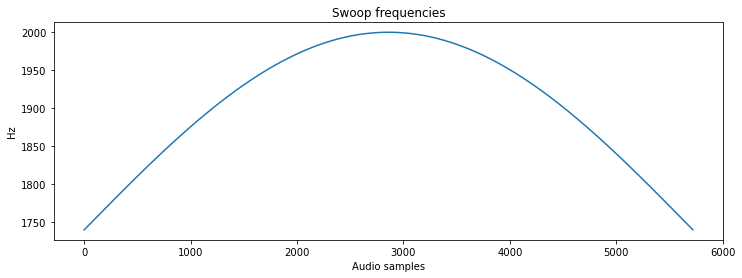

In [232]:
plt.plot(-260*numpy.sin(-numpy.pi/5720*numpy.arange(5720)) + 1740)
plt.rcParams['figure.figsize'] = [12, 4]
plt.xlabel('Audio samples'); plt.ylabel('Hz'); plt.title('Swoop frequencies')
plt.show()

#### Swoop Simulation

Some DDS parameters, including the sample rate (44kHz), a 256-entry sine table, and the constant $2^{32}$:

In [233]:
Fs = 44000 #audio sample rate
sintable = numpy.sin(numpy.linspace(0, 2*numpy.pi, 256))# sine table for DDS
two32 = 2**32 #2^32

And now we can synthesize audio samples.

In [234]:
swoop = list(numpy.zeros(5720)) # a 5720-length array (130ms @ 44kHz) that will hold swoop audio samples
DDS_phase = 0 # current phase
for i in range(len(swoop)):
    frequency = -260.*numpy.sin((-numpy.pi/5720)*i) + 1740 # calculate frequency
    DDS_increment = frequency*two32/Fs # update DDS increment
    DDS_phase += DDS_increment # update DDS phase by increment
    DDS_phase = DDS_phase % (two32 - 1) # need to simulate overflow in python, not necessary in C
    swoop[i] = sintable[int(DDS_phase/(2**24))] # can just shift in C

In order to avoid non-natural clicks, we must ramp the amplitude smoothly from 0 to its max amplitude, and then ramp it down. We'll do this by multiplying the chirp by the linear ramp function shown below:

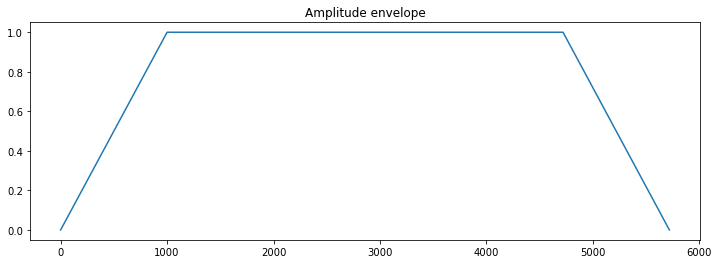

In [235]:
# Amplitude modulate with a linear envelope to avoid clicks
amplitudes = list(numpy.ones(len(swoop)))
amplitudes[0:1000] = list(numpy.linspace(0,1,len(amplitudes[0:1000])))
amplitudes[-1000:] = list(numpy.linspace(0,1,len(amplitudes[-1000:]))[::-1])
amplitudes = numpy.array(amplitudes)
plt.plot(amplitudes);plt.title('Amplitude envelope');plt.show()

# Finish with the swoop
swoop = swoop*amplitudes

Here is what the swoop looks like:

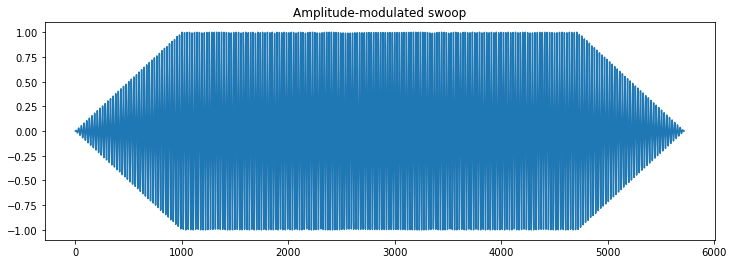

In [236]:
plt.plot(swoop);plt.title('Amplitude-modulated swoop');plt.show()

And here is what it sounds like:

In [237]:
Audio(swoop, rate=44000)

## Practical considerations for implementation on the PIC32

See the [Example code](http://people.ece.cornell.edu/land/courses/ece4760/PIC32/remote/SECABB_python_target_v4_1_3_2.c) on the [Remote interfaces webpage](http://people.ece.cornell.edu/land/courses/ece4760/PIC32/index_remote.html), and notice a few things:

- The timer interrupt (timer 2 in the above example code) is configured to interrupt every 40000000/$F_s$ samples. See this configuration in `main`
- The sine table is built in `main`, and is 256 entries long (each entry is an `int`)
- The sine table ranges from [-2047, 2047]. This is convenient for working with the 12-bit DAC.
- The synthesis frequency (i.e. increment value) is set in the `protothread_python_string` thread.
- Phase accumulation, sine lookup, and communication to DAC happens in the timer 2 ISR. Note that, in the very last step of communication, the value is shifted up to the range of the DAC.